### Importing required modules 

In [11]:
import scipy.io
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt


### Understanding the data

In [12]:
data = scipy.io.loadmat('D:\design lab\case1_10.mat')

print(data.keys())
print(data["__header__"])
print(data["__version__"])
print(data["__globals__"])
a=data["array"]
print(type(data["array"])) 
data["array"].shape

dict_keys(['__header__', '__version__', '__globals__', 'array'])
b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Sun Dec 13 22:04:23 2020'
1.0
[]
<class 'numpy.ndarray'>


(1, 101)

### visualising the data

<class 'numpy.void'>
<class 'numpy.ndarray'> (97,)


[]

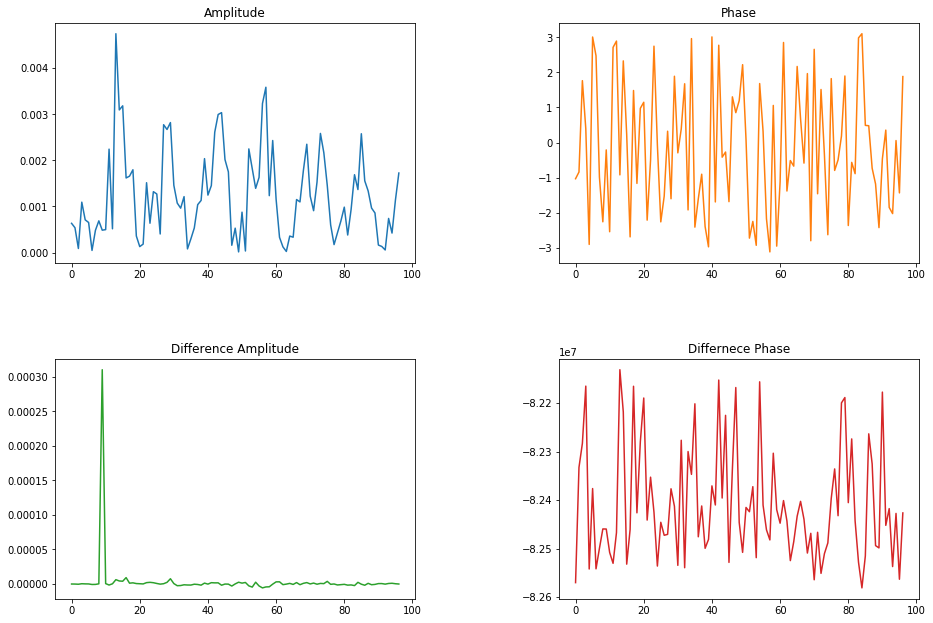

In [13]:
print(type(a[0][0]))
# a[0][0]["Amp"][0].shape
Amp_data=a[0][0]["Amp"][0].reshape(-1)
print(type(Amp_data),Amp_data.shape)

DifferenceAmp_data=data["array"][0][0]["DifferenceAmp"][0]
Phase_data=data["array"][0][0]["Phase"][0]
DiffPhase_data=data["array"][0][0]["DiffPhase"][0]


# fig, axs = plt.subplots(2, 2,gridspec_kw={'width_ratios': [10, 10]})
fig, axs = plt.subplots(2, 2, figsize = (15, 10))
axs[0, 0].plot(Amp_data)
axs[0, 0].set_title('Amplitude')
axs[0, 1].plot(Phase_data, 'tab:orange')
axs[0, 1].set_title('Phase')
axs[1, 0].plot(DifferenceAmp_data, 'tab:green')
axs[1, 0].set_title('Difference Amplitude')
axs[1, 1].plot(DiffPhase_data, 'tab:red')
axs[1, 1].set_title('Differnece Phase')

plt.subplots_adjust(left=0.1, 
                    bottom=0.1,  
                    right=0.9,  
                    top=0.9,  
                    wspace=0.4,  
                    hspace=0.4) 

plt.plot()

#### from the visualising the above data we get realation that difference in Amplitude give a better insight of intrusion  so further computations is done by condisdering the difference in amplitude as main parameter

### Creating dataframe  and adding data for Deep learning model

In [14]:

# creating data frame
col =list()

for i in range(1,98):
    col.append("z"+str(i))
col.extend(["start_point","end_point"])
col.append("isIntrusion")
col.append("intrusion_zone")
df= pd.DataFrame(columns=col)

for zone in range(0,97,10):
    path = f"D:\design lab\case1_{zone}.mat"
    data = scipy.io.loadmat(path)
    data= data["array"]
    for i in range(0,100):
        df_row=data[0][i]["DifferenceAmp"][0]
        df_row=list(df_row)
        df_row=[x.real for x in df_row]
        try:
            d1=data[0][i]["Distance"][0][0]
        except:
            d1=-1
        try:
            d2=data[0][i]["Distance"][0][-1]
        except:
            d2=-1
        if zone == 0:
            intru= 0
        else :
            intru =1

        df_row.extend([d1,d2,intru,zone])
        df.loc[len(df.index)] = df_row
df.to_csv('Data_set.csv')


In [15]:
df

,z1,z2,z3,z4,z5,z6,z7,z8,z9,z10,...,z92,z93,z94,z95,z96,z97,start_point,end_point,isIntrusion,intrusion_zone
0,3.479755e-11,1.729669e-06,-1.074505e-06,1.696733e-06,1.408154e-06,-1.247660e-06,4.392523e-07,-1.822577e-07,-1.978193e-06,-4.215552e-08,...,4.510038e-07,4.933022e-08,-1.209462e-06,8.495825e-08,-1.360888e-07,-8.673617e-19,0.009132,40.904136,0.0,0.0
1,-5.774669e-10,-9.667019e-07,-1.172746e-06,-8.148441e-07,-1.085682e-06,-2.618001e-08,1.536875e-06,-4.809667e-07,7.355430e-08,1.620232e-06,...,-2.559091e-07,9.168085e-07,8.087109e-07,7.078943e-07,4.946341e-07,-6.505213e-19,41.005079,81.806418,0.0,0.0
2,7.974670e-10,5.440602e-07,5.968525e-07,-2.136242e-08,-2.463316e-07,4.842712e-07,-8.860241e-07,6.470653e-07,5.430934e-07,-1.458603e-06,...,-1.413626e-06,1.379344e-07,-3.167636e-07,-5.100911e-07,-4.025520e-07,1.301043e-18,81.912590,122.817894,0.0,0.0
3,-2.959882e-10,3.390513e-07,2.861875e-07,1.237342e-06,1.548561e-06,-4.017564e-07,-7.252355e-07,-5.407646e-07,-1.974723e-08,-8.548541e-07,...,2.269420e-06,3.904686e-07,-5.901801e-07,9.370105e-07,1.087443e-07,-3.373336e-09,122.893114,163.760757,0.0,0.0
4,1.426321e-10,-8.383938e-07,-8.720060e-08,-1.354042e-06,-1.309397e-06,9.558595e-07,9.235621e-07,1.726365e-06,1.359531e-07,-4.867452e-07,...,-2.116315e-06,-1.872924e-06,3.991558e-07,-2.448489e-07,2.474903e-07,3.373336e-09,163.940041,204.690356,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,-5.202278e-11,1.098688e-07,3.952340e-07,6.814923e-07,1.182114e-06,2.072835e-06,-2.556871e-06,1.528595e-06,-6.189744e-07,-9.790348e-07,...,-6.884772e-08,4.673556e-07,8.285986e-08,-3.239867e-07,-6.497717e-08,-4.238809e-09,3890.800196,3931.689324,1.0,90.0
996,2.588881e-11,-2.587924e-07,6.578643e-07,4.216475e-07,7.080463e-08,-8.236128e-07,1.194204e-06,-9.646360e-07,1.542499e-06,9.728379e-07,...,-2.726179e-07,-5.457951e-07,-7.996542e-07,9.085225e-07,-1.156364e-07,4.238809e-09,3931.805823,3972.608877,1.0,90.0
997,3.584851e-11,3.731920e-07,-7.471863e-07,-5.700638e-07,-5.766880e-07,-3.465784e-07,-1.445149e-06,2.766901e-07,-1.502998e-06,4.228883e-07,...,-2.202585e-07,-1.212448e-07,-8.838473e-07,-1.765579e-06,-2.921522e-07,-4.336809e-18,-1.000000,-1.000000,1.0,90.0
998,-1.273899e-10,2.941989e-09,-5.594470e-08,-2.658361e-07,-4.511490e-07,-8.021342e-07,-2.809009e-07,-6.737728e-07,3.515293e-07,8.803461e-07,...,4.155812e-08,1.723475e-07,1.176146e-06,1.166014e-06,6.551157e-07,-2.168404e-18,-1.000000,-1.000000,1.0,90.0


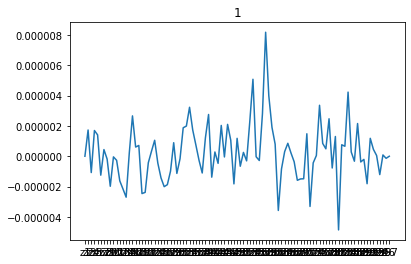

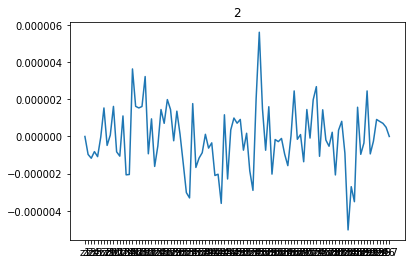

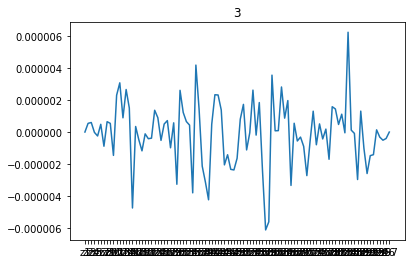

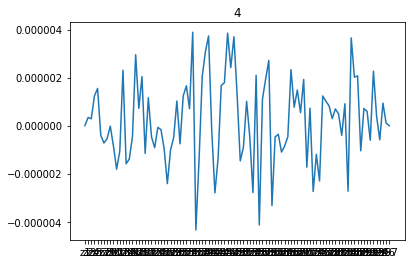

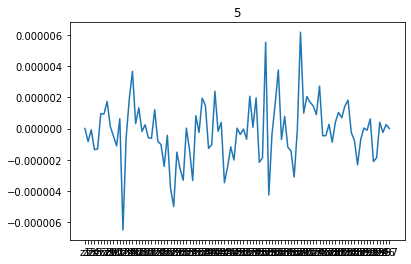

...

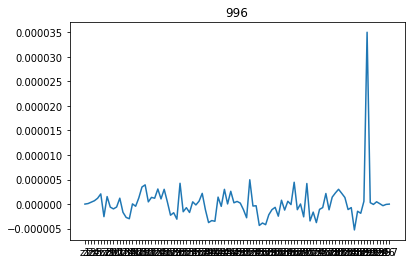

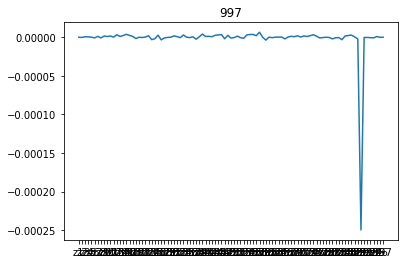

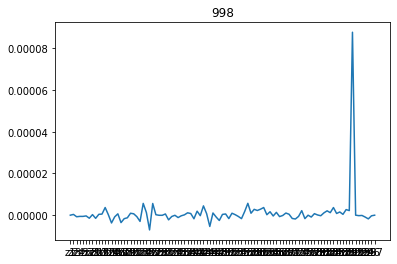

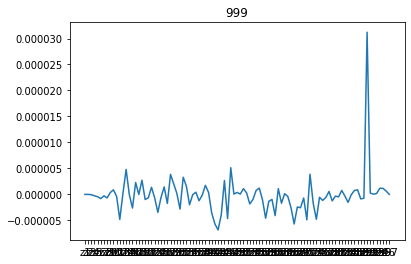

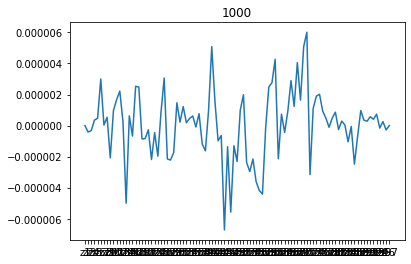

In [16]:
for i in range(1000):
    plt.plot(df.iloc[i,:97])
    plt.title(f"{i+1}")
    plt.show()